# Lab02: Growth models and population dynamics

<div class="alert alert-warning">
If figures/tables are not rendered correctly, make sure your notebook is `trusted` by running `Trust Notebook` operation found in `Commands` (third icon from the top on the toolbar located left-hand side). You can easily find this menu by typing in "trust" in the search box there.
</div>

<div class="alert alert-info">
This is a student version of the notebook that some portions of code are redacted with comments like `#= .. =#`. Students are encouraged to complete the code to get same/similar results as rendered in the notebook. A complete version of the notebook will be provided once the lab session is finished each week.
</div>

In [1]:
using Cropbox

WebIO._IJuliaInit()

## Ex 2.1. Logistic growth model

Incorporate the differential (Eqn 2.4) and integral (Eqn 2.5) forms of the logistic equation using Cropbox package. Using the parameter values in Table 2.1, simulate both forms of the logistic model for 300 days on *daily time steps*. Plot to overlay the two forms in one figure and compare the results. Before running simulations, predict if you expect the results from both models to be identical? Why or why not? Do your simulations support your predictions? Why or why not? Test the behavior of the model with respect to its parameter values.

### Logistic growth (derivative form)

- Eqn 2.4.

$$
\frac{dW}{dt} = rW(1-\frac{W}{W_f}) = rW(\frac{W_f-W}{W_f})
$$

- Table 2.1.

| Symbol | Value | Units | Description |
| :- | :- | :- | :- |
| $t$ | - | $\mathrm{d}$ | Time unit used in the model |
| $r$ | 0.05 | $\mathrm{g}$ $\mathrm{g^{-1}}$ $\mathrm{d^{-1}}$ | Relative (or specific or intrinsic) growth rate |
| $W_0$ | 0.25 | $\mathrm{g}$ | Seed mass or initial biomass |
| $W_f$ | 300 | $\mathrm{g}$ | Potential final mass of a plant |
| $W$ | - | $\mathrm{g}$ | Whole-plant biomass as dry matter (state variable) |

Here is the model specification of Eqn 2.4 implemented on Cropbox framework. See how variables and parameters are declared each line with state verbs (`track`, `preserve`, `accumulate`) and tags (*i.e.* `parameter`, `init`, `u".."`).

- Time variable `t` is set to `track` internal time variable (`context.clock.tick`) in the unit of `d` (day) which is a conversion from default `hr` (hour).
- Parameters `r`, `W0`, `Wf` are set to `preserve` their initial values which are declared in the body. They are tagged `parameter` indicating their values may be replaced by configuration when running simulations.
- As the state variable `W` is defined as a form of derivative ($\frac{dW}{dt}$), we want to integrate its value over time. As Cropbox is essentially a discrete-time modeling framework, what we do here is `accumulate` (summing up) instead of integration over continous time.

In [2]:
@system Eq24(Controller) begin
    t(context.clock.tick) ~ track(u"d")
    
    r: relative_growth_rate => 0.05 ~ preserve(u"g/g/d", parameter)
    W0: initial_biomass => 0.25 ~ preserve(u"g", parameter)
    Wf: potential_final_biomass => 300 ~ preserve(u"g", parameter)
    
    W(r, W, Wf): biomass => begin
        r * W * (Wf - W) / Wf
    end ~ accumulate(u"g", init=W0)
end

Eq24

`simulate(<System>; ..)` function make an instance of the model system and run simulation until `stop` condition is met. Here we use `300u"d"` as a stop condition which indicates the simulation should run for 300 days. The output of `simulate()` is a table-like DataFrame with columns from variables specified in the model.

In [3]:
r24 = simulate(Eq24; stop=300u"d")

Progress: 100%[===========================] Time: 0:00:02 ( 0.30 ms/it)


Row,time,t,r,W0,Wf,W
,Quantity…,Quantity…,Quantity…,Quantity…,Quantity…,Quantity…
1,0.0 hr,0.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.25 g
2,1.0 hr,1.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.25052 g
3,2.0 hr,2.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.251042 g
4,3.0 hr,3.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.251564 g
5,4.0 hr,4.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.252088 g
6,5.0 hr,5.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.252613 g
7,6.0 hr,6.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.253139 g
8,7.0 hr,7.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.253666 g
9,8.0 hr,8.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.254194 g


We can draw a graph with `plot(<DataFrame>, <x>, <y>; ..)` function with the DataFrame output. By default, `kind` option is set to `:scatter` which could be inefficient to plot too many data points, so we instead decided to use `:line` to draw a line plot.

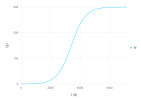

In [4]:
plot(r24, :t, :W; kind=:line)

Note that models in Cropbox have a default clock set in hourly time step (`context.clock.step`). We may change the time step by providing a user configuration. Configuration is in a two-level mapping like `<System> => <Variable> => <Value>`. Cropbox supports many different ways of constructing construction and one simple way is to use a pair of pair.

In [5]:
c = :Clock => :step => 1u"d"

:Clock => (:step => 1 d)

Here we make a configuration `c` for system `Clock` and want to have its variable `step` to be `1u"d"` (1 day). We can take a look at how this pair of pair structure transformed into an actual instance of configuration by calling `configure()` or `@config`.

In [6]:
@config(c)

step,=,1 d


Now we re-run the simulation with the custom configuration `c` for daily time step.

In [7]:
r24 = simulate(Eq24; config=c, stop=300u"d")

Row,time,t,r,W0,Wf,W
,Quantity…,Quantity…,Quantity…,Quantity…,Quantity…,Quantity…
1,0.0 hr,0.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.25 g
2,24.0 hr,1.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.26249 g
3,48.0 hr,2.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.275603 g
4,72.0 hr,3.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.28937 g
5,96.0 hr,4.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.303825 g
6,120.0 hr,5.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.319 g
7,144.0 hr,6.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.334934 g
8,168.0 hr,7.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.351661 g
9,192.0 hr,8.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.369224 g


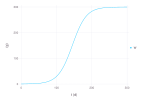

In [8]:
plot(r24, :t, :W; kind=:line)

### Logisitc growth (integrated form): This is an analytical solution of Eqn. 2.4

- Eqn 2.5.

$$
W = \frac{W_0 W_f}{W_0 + (W_f-W_0)e^{-rt}} = \frac{W_f}{1 + (\frac{W_f}{W_0}-1)e^{-rt}}
$$

- Table 2.1.

| Symbol | Value | Units | Description |
| :- | :- | :- | :- |
| $t$ | - | $\mathrm{d}$ | Time unit used in the model |
| $r$ | 0.05 | $\mathrm{g}$ $\mathrm{g^{-1}}$ $\mathrm{d^{-1}}$ | Relative (or specific or intrinsic) growth rate |
| $W_0$ | 0.25 | $\mathrm{g}$ | Seed mass or initial biomass |
| $W_f$ | 300 | $\mathrm{g}$ | Potential final mass of a plant |
| $W$ | - | $\mathrm{g}$ | Whole-plant biomass as dry matter (state variable) |

Specification of system `Eq25` looks very similar to `Eq24` except the state variable `W` is already in the form of integral, not a derivative. Thus, what we need to do is just to make sure re-calculate `W` to `track` its value every time step instead of accumulation / integration.

In [9]:
@system Eq25(Controller) begin
    t(context.clock.tick) ~ track(u"d")
    
    r: relative_growth_rate => #= .. =#  ~ preserve(u"g/g/d", parameter)
    W0: initial_biomass => #= .. =# ~ preserve(u"g", parameter)
    Wf: potential_final_biomass => #= .. =# ~ preserve(u"g", parameter)
    
    W(#= .. =#): biomass => begin
        Wf / (#= .. =# * exp(-r*t))
    end ~ track(u"g")
end

Eq25

In [10]:
r25 = simulate(Eq25; config=c, stop = 300u"d")

Row,time,t,r,W0,Wf,W
,Quantity…,Quantity…,Quantity…,Quantity…,Quantity…,Quantity…
1,0.0 hr,0.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.25 g
2,24.0 hr,1.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.262807 g
3,48.0 hr,2.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.276269 g
4,72.0 hr,3.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.290419 g
5,96.0 hr,4.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.305294 g
6,120.0 hr,5.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.32093 g
7,144.0 hr,6.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.337366 g
8,168.0 hr,7.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.354643 g
9,192.0 hr,8.0 d,0.05 d⁻¹,0.25 g,300.0 g,0.372803 g


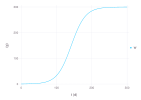

In [11]:
plot(r25, :t, #= .. =#; kind=:line)

### Plot overlay

We can overlay multiple plots with consecutive calls of `plot!(<Plot>, ...)` with a Plot object returned by previous `plot()` or `plot!()` function.

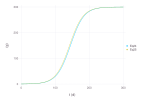

In [12]:
p = plot(r24, :t, :W; kind=:line, name="Eq24")
plot!(p, r25, :t, :W; kind=:line, name="Eq25")

Cropbox also provides some high-level plotting functions to make a plot without manually running simulations first. One form of `visualize()` function supports `visualize([<System>..], <x>, <y>; <simulate() options>.., <plot() options..>)` to make an overlay plot in one line.

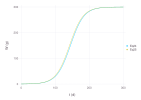

In [13]:
visualize([Eq24, Eq25], :t, :W; config=c, stop=300u"d", kind=:line)

You may notice a small difference between two implementations of logistic growth models. Answer the question above and discuss with others.

## Ex 2.2. The Lotka-Volterra model for competition between two species

Create a system to implement the Lotka-Volterra competition model (Eqn 2.8) using $\textit{Cropbox}$. Using the parameter and initial values of your choice, simulate the population dynamics of two annual plant species (e.g., crop and weed) competing for spaces, light, water, and nutrients. Study the system behavior by experimenting with initial conditions and parameter values. Do you think the model demonstrate reasonable predictions that are consistent with your understanding of interspecific competition between two plant species?

- Eqn 2.8

$$
\begin{equation}
\begin{split}    
    \label{eq:LV-compet}
    &\frac{dN_1}{dt} = r_1N_1(1-\frac{N_1+\alpha N_2}{K_1}) = r_1 N_1(\frac{K_1-N_1-\alpha N_2}{K_1})\\
    &\frac{dN_2}{dt} = r_2N_2(1-\frac{N_2+\beta N_1}{K_2}) = r_2 N_2(\frac{K_2-N_2-\beta N_1}{K_2})
\end{split}
\end{equation}
$$

See table 2.1 of the lecture note for parameter definitions.

In [14]:
@system LV_competition(Controller) begin
    t(context.clock.time) ~ track(u"d")
    N1(r1, α, N1, N2, K1): sp1_population => #= .. =# ~ accumulate(init = #= .. =#)
    N2(r2, β, N2, N1, K2): sp2_population => #= .. =# ~ accumulate(init = #= .. =#)
    
    N1_0: initial_sp1_population => 100 ~ preserve(parameter)
    N2_0: initial_sp2_population => 20 ~ preserve(parameter)
    
    r1: RGR_sp1 => 0.15 ~ preserve(u"d^-1",parameter)
    r2: RGR_sp2 => 0.2 ~ preserve(u"d^-1",parameter)
    α: effect_of_sp2_on_sp1 => 0.5 ~preserve(parameter)
    β: effect_of_sp1_on_sp2 => 0.2 ~preserve(parameter)
    K1: carrying_capacity_sp1 => 200 ~ preserve(parameter)
    K2: carrying_capacity_sp2 => 200 ~ preserve(parameter)
end

LV_competition

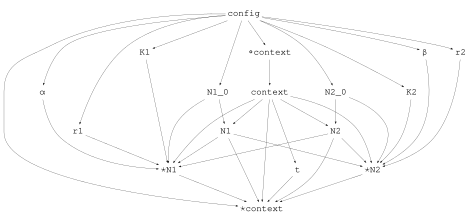

In [15]:
Cropbox.dependency(LV_competition)

Here, we make a configuration for setting parameters for `LV_competition` system we've just made above. We'll use a daily time step.

In [16]:
cLV_c = @config (
    :Clock => (;
        step = 1u"d",
    ),
    :LV_competition => (;
        r1 = 0.15, r2 = 0.2,
        α = 0.5, β = 0.2,
        K1 = 200, K2 = 200,
        N1_0 = 100, N2_0 = 20,
    ),
)

step,=,1 d
r1,=,0.15
r2,=,0.2
α,=,0.5
β,=,0.2
K1,=,200
K2,=,200
N1_0,=,100
N2_0,=,20


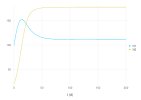

In [17]:
visualize(LV_competition, :t, [:N1, :N2]; config=cLV_c, stop=200u"d", kind=:line)

$\textbf{To-do:}$ Experiment with different sets of parameter values and initial conditions to study the model behavior by changing the values in `cLV_c` config.

## Ex 2.3.

Create a system to implement the density-independent Lotka-Volterra model (Eqn 2.9) using Cropbox package. Using your guesstimates, find the set of parameter values and initial conditions by eyes that mimic the population dynamics shown in Fig. 2.1b. Repeat this process until you are satisfied with the result. What are their values? Do you think those values are ecologically realistic?

### Density-independent Lotka-Volterra model for predator-prey interactions

- Eqn 2.9.

$$
\begin{align}
\frac{dN}{dt} &= rN - aNP \\
\frac{dP}{dt} &= caNP - mP \\
\end{align}
$$

- Table 2.1.

| Symbol | Value | Units | Description |
| :- | :- | :- | :- |
| $t$ | - | $\mathrm{yr}$ | Time unit used in the model |
| $N$ | - | - | Prey population as number of individuals (state variable) |
| $P$ | - | - | Predator population as number of individuals (state variable) |
| $r$ | - | $\mathrm{yr^{-1}}$ | Per capita growth rate of prey population |
| $a$ | - | $\mathrm{yr^{-1}}$ | Attack rate or predation rate |
| $c$ | - | - | Conversion efficiency of an eaten prey into new predator; predator's reproduction efficiency per prey consumed) |
| $m$ | - | $\mathrm{yr^{-1}}$ | Mortality rate of predator population |

- Fig. 2.1b

![Fig. 2.1b](http://www2.nau.edu/lrm22/lessons/predator_prey/hare_lynx_graph.png)

Model specification of `LotkaVolterra` resembles what we did with `Eq24` for logistic growth model in a derivative form.

In [18]:
@system LV_predation(Controller) begin
    t(context.clock.time) ~ track(u"yr")
    
    N(N, P, r, a): prey_population => #= .. =# ~ #= .. =#
    P(N, P, c, a, m): predator_population => #= .. =# - m*P ~ #= .. =#
    
    N0: prey_initial_population ~ preserve(parameter)
    P0: predator_initial_population ~ preserve(parameter)
    
    r: prey_growth_rate ~ preserve(u"yr^-1", parameter)
    a: predation_rate ~ preserve(u"yr^-1", parameter)
    c: predator_reproduction_rate ~ preserve(parameter)
    m: predator_mortality_rate ~ preserve(u"yr^-1", parameter)
end

LV_predation

We can take a look at the dependency between variables declared in the system by calling `Cropbox.dependency(<System>)`.

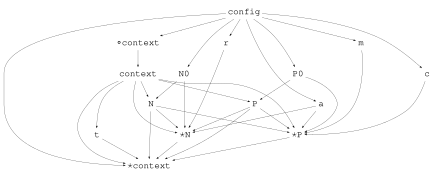

In [19]:
Cropbox.dependency(LV_predation)

Similarly, a hierarchy between mix-in systems can be drawn by `Cropbox.hierarchy(<System>)`. Solid line indicates *has* relationship meaning the target system contains an instance of source system. Dashed line indicates *is* relationship meaning the target system is composed of source system as a mix-in.

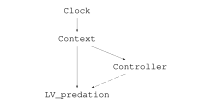

In [20]:
Cropbox.hierarchy(LV_predation)

Here, we make a configuration for setting parameters for `LV_predation` system we've just made above. We'll use a daily time step.

In [21]:
cLV_p = @config (
    :Clock => (;
        step = 1u"d",
    ),
    :LV_predation => (;
        r = 0.6,
        a = 0.02,
        c = 0.5,
        m = 0.5,
        N0 = 20,
        P0 = 30,
    ),
)

step,=,1 d
r,=,0.6
a,=,0.02
c,=,0.5
m,=,0.5
N0,=,20
P0,=,30


Let's make a simulation plot and see how it compares to the original dataset. Note we use a variant `visualize(<System>, <x>, [<y>..]; ..)` with multiple target variables mapped to multiple series of lines.

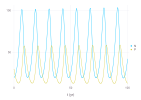

In [22]:
visualize(LV_predation, :t, [:N, :P]; config=cLV_p, stop=100u"yr", kind=:line)

Repeat this process until you are satisfied with the result. What are their values? Do you think those values are ecologically realistic?

### Extra: Analysis of model behavior using phase-plane plot
Here we will take a look at the phase-plane plot and analyze how the model behaves based on its initial conditions and parameter values. We also determine what the initial conditions would lead to neutral stability at the steady state with respect to your choice of parameter values (See Edelstein-Keshet, 2005, Ch 6: https://doi.org/10.1137/1.9780898719147.ch6). 

To examine the parameter values and calculate the stability points, we will create an instance of the simulation based on the previous configuration, with some variables added.

In [23]:
@system LV_stable(LV_predation, Controller) begin
    N̄(m, a, c): stable_prey_population     => m / (a*c) ~ preserve
    P̄(r, a):    stable_predator_population => r / a     ~ preserve
end

LV_stable

In [24]:
lv = instance(LV_stable; config = cLV_p)

context,,=,<Context>
config,,=,<Config>
t,,=,0.0 yr
N,(prey_population),=,20.0
P,(predator_population),=,30.0
N0,(prey_initial_population),=,20.0
P0,(predator_initial_population),=,30.0
r,(prey_growth_rate),=,0.6 yr⁻¹
a,(predation_rate),=,0.02 yr⁻¹
c,(predator_reproduction_rate),=,0.5
m,(predator_mortality_rate),=,0.5 yr⁻¹


Here we calculate the prey population ($\bar{N}$) that leads to the neutral stability. The vertical line that goes through this point determines the predator nullcline.  

In [25]:
lv.N̄

50.0

Here we calculate the prey population ($\bar{P}$) that leads to the neutral stability. The line going through this point determines the prey nullcline. 

In [26]:
lv.P̄

30.0

Putting the simulation result into a dataframe named `ex22` for Lab exercise 2.2. Note that we use `snap` option to collect output for every 10 days, instead of 1-day interval we set for `Clock`, to avoid potential slowdown and stroage issue caused by a massive amount of data points.

In [27]:
ex23 = simulate(LV_predation; config = cLV_p, stop = 100u"yr", snap = 10u"d");

Here we use a Julia package called Plots for plotting the phase-plane figure. If the package has not been installed, uncomment the first line to install it once and re-comment it after installling it. 

Study the plot. See where $\bar{N}$ and $\bar{P}$ intersect in the plane and how the N and P populations change with respect to the intersection. Try changing the initial conditions ($N_0$ and $P_0$) closer to $\bar{N}$ and $\bar{P}$ and observe how the model behavior changes.

In [28]:
p = visualize(ex23, :N, :P;
    name = "N:P",
    xlab = "N (Prey Population)",
    ylab = "P (Predator Population)",
)
p = visualize!(p, lv.P̄'; kind = :hline, name = "P̄ = r/a")
p = visualize!(p, lv.N̄'; kind = :vline, name = "N̄ = m/ac")
p = visualize!(p, [lv.N0'], [lv.P0']; kind = :scatter, name = "Initial point")
p = visualize!(p, [lv.N̄'],  [lv.P̄'];  kind = :scatter, name = "Stable state")

We can save this plot as PDF file using `Cairo` and `Fontconfig` packages. If the packages are not installed, run:
`import Pkg; Pkg.add("Cairo")` and `import Pkg; Pkg.add("Fontconfig")`

In [29]:
using Cairo, Fontconfig
p[] |> Cropbox.Gadfly.PDF("fig1-LV_predation-phaseplane.pdf")

Let's make a simulation plot and see how it compares to the original dataset. Note we use a variant `visualize(<System>, <x>, [<y>..]; ..)` with multiple target variables mapped to multiple series of lines.

### Ex 2.4. Density-dependent Lotka-Volterra model for predator-prey interactions

Repeat the previous exercise for the *density-dependent* Lotka-Volterra model (Eqn 2.10). Does this model do a better job mimicking the observations than the density-independent model? Why do you think that's the case? Which model do you prefer to use and why?

- Eqn 2.10.

$$
\begin{align}
\frac{dN}{dt} &= rN-\frac{r}{K}N^2-aNP \\
\frac{dP}{dt} &= caNP-mP \\
\end{align}
$$

- Table 2.1.

| Symbol | Value | Units | Description |
| :- | :- | :- | :- |
| $t$ | - | $\mathrm{yr}$ | Time unit used in the model |
| $N$ | - | - | Prey population as number of individuals (state variable) |
| $P$ | - | - | Predator population as number of individuals (state variable) |
| $r$ | - | $\mathrm{yr^{-1}}$ | Per capita growth rate of prey population |
| $a$ | - | $\mathrm{yr^{-1}}$ | Attack rate or predation rate |
| $c$ | - | - | Conversion efficiency of an eaten prey into new predator; predator's reproduction efficiency per prey consumed) |
| $m$ | - | $\mathrm{yr^{-1}}$ | Mortality rate of predator population |
| $K$ | - | - | Carrying capacity of the system for prey population |

We can make a density-dependent version of the model `LotkaVoleterraDD` by reusing `LotkaVoleterra` as a mix-in. Note that base model `LotkaVoletrra` is indicated in the first line of arguments list of `@system` declaration, meaning declarations of variables for `LotkaVoletrra` are imported and available for `LotkaVolterraDD`. That's why we only need to provide a change or difference in terms of variable declaration in the new model, leading to a much compact specification. Here declaration of prey population `N` is overwritten by a new statement with an additionally introduced parameter `K` for carrying capacity.

In [30]:
@system DDLV_predation(LV_predation, Controller) begin
    N(N, P, K, r, a): prey_population => begin
        #= .. =#
    end ~ accumulate(init=N0)
    
    K: carrying_capacity ~ preserve(parameter)
end

DDLV_predation

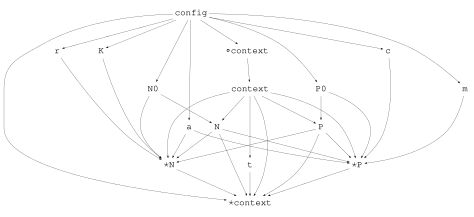

In [31]:
Cropbox.dependency(DDLV_predation)

A hierarchy graph shows how `DDLV_predation` is based on `LV_predation` as a mix-in.

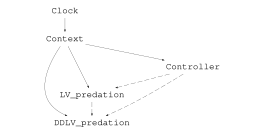

In [32]:
Cropbox.hierarchy(DDLV_predation)

Similarly to how a new system can be derived from existing ones, a new configuration can be also built by a collection of existing configruations in the form of `(A, B, C...)` where a new configuration is based on the existing configuration A, overlaid by B, then overlaid by C, and so on.

Here we make a new configuration `lvddc` for `LotkaVolterraDD` based on `lvc` for `LotkaVolterra` with an additional parameter for carrying capacity `K`.

In [33]:
cDDLV_p = @config (cLV_p,
    :DDLV_predation => (;
        K = 100,
    ),
)

step,=,1 d
r,=,0.6
a,=,0.02
c,=,0.5
m,=,0.5
N0,=,20
P0,=,30
K,=,100


Let's run the simulation for `LotkaVolterraDD` and a new configuration `lvddc`.

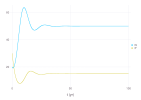

In [34]:
visualize(DDLV_predation, #= .. =#, #= .. =#; config=cDDLV_p, #= .. =#, kind=:line)

Does thismodel do a better job mimicking the observations than the density-independent model? Why do you think that’s the case? Which model do you prefer to use and why?

### Extra: Analysis of density-dependent LV predation model behavior using phase-plane plot
As we did for ex.2.3., here we will take a look at the phase-plane plot and analyze how the model behaves based on its initial conditions and parameter values. We also determine what the initial conditions would lead to neutral stability at the steady state with respect to your choice of parameter values (See Edelstein-Keshet, 2005, Ch 6: https://doi.org/10.1137/1.9780898719147.ch6). 

To examine the parameter values and calculate the stability points, we will create an instance of the simulation based on the previous configuration, with some variables added.

In [35]:
@system DDLV_stable(DDLV_predation, Controller) begin
    N̄(m, a, c):       stable_prey_population     => m / (a*c)             ~ preserve
    P̄(r, a, m, c, K): stable_predator_population => (r/a) - m*r/(a*c*a*K) ~ preserve
end

DDLV_stable

In [36]:
lvdd = instance(DDLV_stable; config = cDDLV_p)

context,,=,<Context>
config,,=,<Config>
t,,=,0.0 yr
N,(prey_population),=,20.0
P,(predator_population),=,30.0
N0,(prey_initial_population),=,20.0
P0,(predator_initial_population),=,30.0
r,(prey_growth_rate),=,0.6 yr⁻¹
a,(predation_rate),=,0.02 yr⁻¹
c,(predator_reproduction_rate),=,0.5
m,(predator_mortality_rate),=,0.5 yr⁻¹


Here we calculate the prey population ($\bar{N}$) that leads to the neutral stability. The vertical line that goes through this point determines the predator nullcline.  

In [37]:
lvdd.N̄'

50.0

Here we calculate the prey population ($\bar{P}$) that leads to the neutral stability. The line going through this point determines the prey nullcline. 

In [38]:
lvdd.P̄

15.0

Putting the simulation result into a dataframe named `ex23`for Lab exercise 2.3.

In [39]:
ex24 = simulate(DDLV_stable; config = cDDLV_p, stop = 100u"yr", snap = 10u"d");

Progress: 100%[===========================] Time: 0:00:01 (32.18 μs/it)


Here we use a Julia package called Plots for plotting the phase-plane figure. If the package has not been installed, uncomment the first line to install it once and re-comment it after installling it. 

Study the plot. See where $\bar{N}$ and $\bar{P}$ intersect in the plane and how the N and P populations change with respect to the intersection. Try changing the initial conditions ($N_0$ and $P_0$) closer to $\bar{N}$ and $\bar{P}$ and observe how the model behavior changes.

In [40]:
p = visualize(ex24, :N, :P; name = "N:P", xlab = "N (Prey Population)", ylab = "P (Predator Population)")
p = let x = range(0, stop = lvdd.K', length = 100) |> collect,
        y = (lvdd.r' / lvdd.a') .* (1 .- x ./ lvdd.K')
    visualize!(p, x, y; kind = :line, name = "N nullcline")
end
p = visualize!(p, lvdd.N̄';    kind = :vline, name = "P nullcline")
p = visualize!(p, [lvdd.N0'], [lvdd.P0']; kind = :scatter, name = "Initial point")
p = visualize!(p, [lvdd.N̄'],  [lvdd.P̄'];  kind = :scatter, name = "Stable state")

In [41]:
p[] |> Cropbox.Gadfly.PDF("fig2-DDLV_predation-phaseplane.pdf")

## Cropbox Internals

Let's make an instance of `LotkaVolterraDD` system with configuration `lvddc`.

In [47]:
s = instance(DDLV_predation; config=cDDLV_p)

context,,=,<Context>
config,,=,<Config>
t,,=,0.0 yr
N,(prey_population),=,20.0
P,(predator_population),=,30.0
N0,(prey_initial_population),=,20.0
P0,(predator_initial_population),=,30.0
r,(prey_growth_rate),=,0.6 yr⁻¹
a,(predation_rate),=,0.02 yr⁻¹
c,(predator_reproduction_rate),=,0.5
m,(predator_mortality_rate),=,0.5 yr⁻¹


#### Alias

We have two state variables `N` and `P` as kind of `accumulate`. Rate calculation for each variable looks almost same as mathematical equation. Note that `N` and `P` are short abbreviations for much longer names `prey_population` and `predator_population`. By giving a descriptive long alias to the variable while referring it with a short name, we can keep our model specification concise yet expressive enough.

In [48]:
s.N

20.0

In [49]:
s.prey_population

20.0

#### State vs. Value

`s.prey_population` and `s.N` above point out to an instance of the exactly same state variable.

In [50]:
s.prey_population === s.N

true

Note that what they return is not an actual value stored in the state variable, but the data structure (of type `State`) itself. We can get the type of variable with `typeof()` function provided by Julia.

In [51]:
typeof(s.N)

Cropbox.Accumulate{Float64, Unitful.Quantity{Float64, 𝐓, Unitful.FreeUnits{(hr,), 𝐓, nothing}}, Unitful.Quantity{Float64, 𝐓⁻¹, Unitful.FreeUnits{(hr⁻¹,), 𝐓⁻¹, nothing}}}

To get an actual value stored in the state variable, we can use `Cropbox.value()` function.

In [52]:
value(s.N)

20.0

Alternatively, we can also use postfix adjoint operator `'` or dereference operator `[]` which is specifically defined as a shortcut to `Cropbox.value()` in the case of `State` type.

In [53]:
s.N'

20.0

In [54]:
typeof(s.N')

Float64

In [55]:
s.N[]

20.0

In [56]:
typeof(s.N[])

Float64

#### Units

Note that we defined units for rate parameters `a`, `b`, and `c`. `u".."` is a string format used by [Unitful.jl](https://github.com/PainterQubits/Unitful.jl) package which provides unit conversion functionality for our framework.

In [57]:
u"yr^-1"

yr⁻¹

`u"yr^-1"` tag in our model specification is actually a shorthand notation for `unit=u"yr^-1"`. For example, `a ~ preserve(u"m")` expands to `a ~ preserve(unit=u"m")`.

By default, time variables used by Cropbox framework are defined in an hourly unit (`u"hr"`).
For simulation, you can still choose whichever time step you'd like to use by changing `step` parameter of `Clock` in `Context`.

You should be cautious when using some larger time units like month and year. `1 yr` is defined to be `365.25 d` following the [convention](https://github.com/PainterQubits/Unitful.jl/pull/288) used in Astronomy. There is no unit for month due to ambiguity.

We can check the unit of state variable or its value with `Cropbox.unittype()`.

In [58]:
s.a

0.02 yr⁻¹

In [59]:
Cropbox.unittype(s.a)

yr⁻¹

In [60]:
Cropbox.unittype(s.a')

yr⁻¹

#### Parameter

We can look up a list of default parameters declared for a given system by calling `parameters()`.

In [61]:
parameters(DDLV_predation)

N0,=,nothing
a,=,nothing
K,=,nothing
r,=,nothing
P0,=,nothing
m,=,nothing
c,=,nothing


Since `DDLV_predation` had no default parameter values declared in the model itself, let's instead take a look at `LV_competition` system.

In [62]:
parameters(LV_competition)

N1_0,=,100
α,=,0.5
r1,=,0.15 d⁻¹
K1,=,200
N2_0,=,20
K2,=,200
β,=,0.2
r2,=,0.2 d⁻¹


If you prefer long descriptive names, set `alias=true`.

In [63]:
parameters(LV_competition, alias=true)

initial_sp1_population,=,100
effect_of_sp2_on_sp1,=,0.5
RGR_sp1,=,0.15 d⁻¹
carrying_capacity_sp1,=,200
initial_sp2_population,=,20
carrying_capacity_sp2,=,200
effect_of_sp1_on_sp2,=,0.2
RGR_sp2,=,0.2 d⁻¹


It also accepts `recursive` to look up other systems referred in the target system. For example, every system has `Context` which contains `Clock` and all of their parameters can be retrieved as below.

In [64]:
parameters(LV_competition, recursive=true)

init,=,0 hr
step,=,1 hr
N1_0,=,100
α,=,0.5
r1,=,0.15 d⁻¹
K1,=,200
N2_0,=,20
K2,=,200
β,=,0.2
r2,=,0.2 d⁻¹


## HW 2.3.

In this exercise, you will use the density dependent L-V model to find the parameter combinations and initial conditions of state variables that satisfy the following scenarios for 100 years. Note that there could be multiple solutions. 

Please show one set of parameters that works for each case but do make sure to <b>provide your own discussion and interpretation</b> based on biological meaning of the parameter values and their ecological contexts.

Shown below is the configuration we used above. Let's try making a different set of parameters for simulating a desired behavior. Note that the figures rendered below are just examples. You don't have to replicate them.


In [42]:
@config(cDDLV_p)

step,=,1 d
r,=,0.6
a,=,0.02
c,=,0.5
m,=,0.5
N0,=,20
P0,=,30
K,=,100


### a. Prey dies out slowly, then predator dies out.

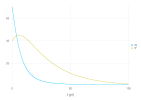

In [43]:
visualize(DDLV_predation, :t, [:N, :P]; config=(cDDLV_p,
    :DDLV_predation => (;
            r = #= .. =#,
            a = #= .. =#,
            c = #= .. =#,
            m = #= .. =#,
            K = #= .. =#,
            N0 = #= .. =#,
            P0 = #= .. =#,
    ),
), stop=100u"yr", kind=:line)

### b. Predator dies out and prey does not.

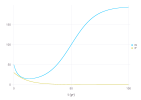

In [44]:
visualize(DDLV_predation, :t, [:N, :P]; config=(cDDLV_p,
    :DDLV_predation => (;
            r = #= .. =#,
            a = #= .. =#,
            c = #= .. =#,
            m = #= .. =#,
            K = #= .. =#,
            N0 = #= .. =#,
            P0 = #= .. =#,
    ),
), stop=100u"yr", kind=:line)

### c. Both predator and prey populations oscillate for the entire period.

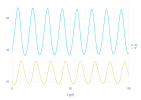

In [45]:
visualize(DDLV_predation, :t, [:N, :P]; config=(cDDLV_p,
    :DDLV_predation => (;
            r = #= .. =#,
            a = #= .. =#,
            c = #= .. =#,
            m = #= .. =#,
            K = #= .. =#,
            N0 = #= .. =#,
            P0 = #= .. =#,
    ),
), stop=100u"yr", kind=:line)

### d. Both predator and prey populations stabilize over time to reach an equilibrium.

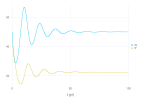

In [46]:
visualize(DDLV_predation, :t, [:N, :P]; config=(cDDLV_p,
    :DDLV_predation => (;
            r = #= .. =#,
            a = #= .. =#,
            c = #= .. =#,
            m = #= .. =#,
            K = #= .. =#,
            N0 = #= .. =#,
            P0 = #= .. =#,
    ),
), stop=100u"yr", kind=:line)